In [58]:
import torch
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
import torchvision.models as models
import torch.nn as nn
import torch.optim as optim
from sklearn.model_selection import train_test_split
from torchvision import models, transforms
import matplotlib.pyplot as plt
import os
from torchvision import datasets
from PIL import Image
import random
import torch.nn.functional as F
import pandas as pd

import warnings
warnings.filterwarnings("ignore")

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

## Load pre trained model

In [2]:
model = models.resnet18(pretrained=True)

# Modify the final fully connected layer
model.fc = nn.Linear(512, 10)  
model.load_state_dict(torch.load('datasets/CV Assignment 2/Q2/network_visualization.pth', map_location=device))
model.to(device) 
model.eval()  

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

## Load images

In [21]:
import os
import random

data_dir = 'datasets/CV Assignment 2/Q2/network visualization'

def load_subset(data_dir, index = 0):
    image_paths = []
    class_labels = []  # To store class labels
    label_to_class = {}  # Mapping from label index to class name
    
    # Get all class names (subdirectories in data_dir)
    classes = os.listdir(data_dir)  
    print("Classes found:", classes)

    # Sort classes to ensure consistent order
    classes.sort()

    # Create a consistent mapping from class names to integer labels
    for idx, class_name in enumerate(classes):
        class_folder = os.path.join(data_dir, class_name)
        
        # Only consider subfolders (ensure it's a valid class folder)
        if os.path.isdir(class_folder):  
            images = os.listdir(class_folder)  # List all images in the folder
            if images:
                image_path = os.path.join(class_folder, images[index])  # Take the first image
                image_paths.append(image_path)
                class_labels.append(idx)  # Append the integer label for the class
                label_to_class[idx] = class_name  # Store the class name corresponding to the integer label

    return image_paths, class_labels, label_to_class

# Load the subset of images (one from each class)
image_paths, class_labels, label_to_class = load_subset(data_dir, index = 2)

# Display the results
print(f"Image Paths: {image_paths}")
print(f"Class Labels (Integer): {class_labels}")
print(f"Label to Class Mapping: {label_to_class}")

Classes found: ['arctic fox', 'corgi', 'electric ray', 'goldfish', 'hammerhead shark', 'horse', 'hummingbird', 'indigo finch', 'puma', 'red panda']
Image Paths: ['datasets/CV Assignment 2/Q2/network visualization\\arctic fox\\arctic fox_3.JPEG', 'datasets/CV Assignment 2/Q2/network visualization\\corgi\\corgi_3.JPEG', 'datasets/CV Assignment 2/Q2/network visualization\\electric ray\\electric ray_3.JPEG', 'datasets/CV Assignment 2/Q2/network visualization\\goldfish\\goldfish_3.JPEG', 'datasets/CV Assignment 2/Q2/network visualization\\hammerhead shark\\hammerhead shark_3.JPEG', 'datasets/CV Assignment 2/Q2/network visualization\\horse\\horse_3.JPEG', 'datasets/CV Assignment 2/Q2/network visualization\\hummingbird\\hummingbird_3.JPEG', 'datasets/CV Assignment 2/Q2/network visualization\\indigo finch\\indigo finch_3.JPEG', 'datasets/CV Assignment 2/Q2/network visualization\\puma\\puma_3.JPEG', 'datasets/CV Assignment 2/Q2/network visualization\\red panda\\red panda_3.JPEG']
Class Labels (

## Preprocess images

In [22]:
preprocess = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize to the size expected by ResNet18
    transforms.ToTensor(),          # Convert image to tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalization
])

def preprocess_image(image_path, processed = "False"):
    image = Image.open(image_path)  # Open the image
    if(processed=="True"):
        image = preprocess(image)  # Apply the preprocessing pipeline
    return image

original_images = [preprocess_image(image_path, processed="False") for image_path in image_paths]
preprocessed_images = [preprocess_image(image_path, processed="True") for image_path in image_paths]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1632845].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.0996952].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7240347..2.2739873].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0357141..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.8004202].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8081232..2.5702832].


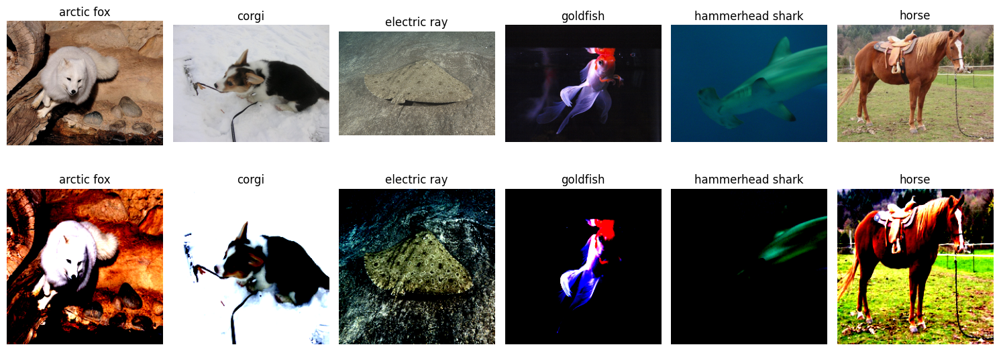

In [23]:
def show_images(images, processed_images, class_labels, label_to_class, titles, processed="False"):
    fig, axes = plt.subplots(2, len(images), figsize=(15, 6))
    
    if len(images) == 1:
        axes = [axes]  # Make sure axes is always iterable
    
    for i, (image, label) in enumerate(zip(images, class_labels)):
        # Convert image tensor to numpy and transpose to HWC format for matplotlib
        class_name = label_to_class[label]
        axes[0][i].imshow(image)
        axes[0][i].set_title(class_name) 
        axes[0][i].axis('off')
        
    for i, (processed, label) in enumerate(zip(processed_images, class_labels)):
        if titles is not None:
            axes[i].set_title(titles[i])
        class_name = label_to_class[label]
        axes[1][i].imshow(processed.permute(1, 2, 0).detach().cpu().numpy())
        axes[1][i].set_title(class_name)
        axes[1][i].axis('off')
    
    plt.tight_layout()
    plt.show()

show_images(original_images[:6], preprocessed_images[:6], class_labels[:6], label_to_class, titles=None, processed="True")

# 2.1

In [24]:
def compute_saliency(image, model, label):
    image.requires_grad_()  # Enable gradient computation
    
    # Forward pass
    output = model(image.unsqueeze(0))  # Add batch dimension
    score = output[0, label]  # Get the score for the correct class

    # Backward pass (compute the gradient of score with respect to the image)
    model.zero_grad()  # Zero out previous gradients
    score.backward()

    # Get the absolute value of gradients
    saliency = image.grad.data.abs().max(dim=0, keepdim=False)[0]  # Max over the color channels
    # saliency = saliency / saliency.max() 
    return saliency

def visualize_saliency(images, saliency_maps, labels, predicted_labels, label_to_class):
    num_images = len(images)
    cols = 5
    rows = 4  

    fig, axes = plt.subplots(rows, cols, figsize=(10, 9))  

    for i in range(num_images):
        # Convert image tensor to numpy array for visualization
        image = images[i].squeeze().detach().permute(1, 2, 0).cpu().numpy()
        saliency = saliency_maps[i].squeeze().cpu().numpy()

        gt_class_name = label_to_class[labels[i]]
        pred_class_name = label_to_class[predicted_labels[i]]

        row_idx = (i // cols) * 2
        col_idx = i % cols
        
        ax = axes[row_idx, col_idx]
        ax.imshow(image)
        ax.set_title(f'class: {gt_class_name}')
        ax.axis('off') 

        row_idx = (i // cols) * 2 + 1
        ax = axes[row_idx, col_idx]
        ax.imshow(saliency, cmap='hot', aspect='auto')
        ax.axis('off') 

    plt.tight_layout()
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1632845].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.0996952].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7240347..2.2739873].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0357141..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.8004202].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8081232..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.605

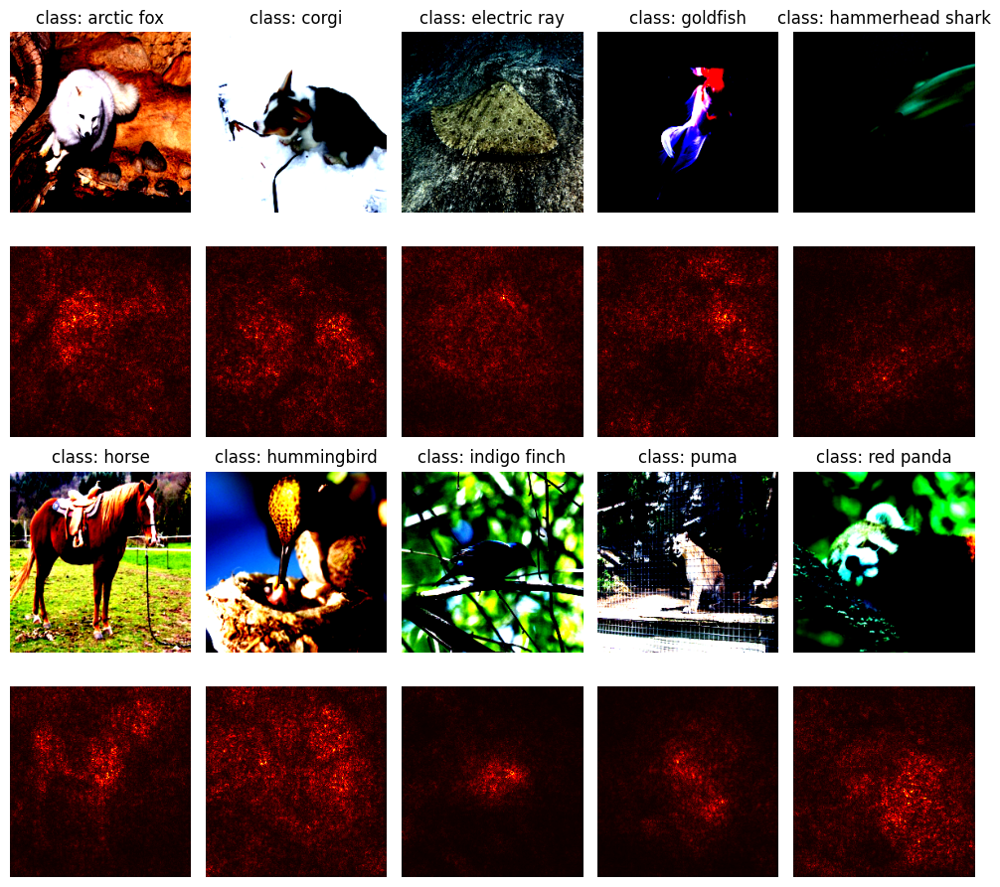

In [25]:
image_indices = list(range(10))  
images = [preprocessed_images[i].to(device) for i in image_indices]
labels = class_labels[:10]  
saliency_maps = []
predicted_labels = []

for i in image_indices:
    image = images[i]
    label = labels[i]
    saliency_map = compute_saliency(image, model, label)
    saliency_maps.append(saliency_map)
    predicted_label = torch.argmax(model(image.unsqueeze(0))).item()
    predicted_labels.append(predicted_label)
    
visualize_saliency(images, saliency_maps, labels, predicted_labels, label_to_class)

### Masking

In [26]:
def modify_image_with_saliency(image, saliency_map, threshold_type='mean', use_gaussian_noise=False, noise_mean=0, noise_std=1, retain_percent=80):
    
    # Ensure saliency_map is in the correct shape (H, W)
    if saliency_map.dim() == 3:
        saliency_map = saliency_map.squeeze(0)  # Remove the channel dimension
    
    flat_saliency = saliency_map.view(-1)
    num_pixels = flat_saliency.size(0)  
    retain_pixels_count = int(num_pixels * retain_percent / 100)
    
    # Sort the saliency values and get the top retain_pixels_count indices
    sorted_indices = torch.argsort(flat_saliency, descending=True)[:retain_pixels_count]
    
    # Create a mask where the top retain_pixels_count pixels are True, and the rest are False
    mask = torch.zeros_like(flat_saliency, dtype=torch.bool)
    mask[sorted_indices] = 1
    
    mask = mask.view(saliency_map.size())
    
    mask = mask.unsqueeze(0).expand_as(image)  # Expand mask to match the image shape (3, H, W)
    
    modified_image = image.clone()
    
    # Pixels that don't meet the threshold are either set to (0, 0, 0) or replaced with Gaussian noise
    if use_gaussian_noise:
        noise = torch.randn_like(image) * noise_std + noise_mean
        modified_image[~mask] = noise[~mask] 
    else:
        modified_image[~mask] = 0  #
    
    return modified_image

In [75]:
import torch
import matplotlib.pyplot as plt

def visualize_all_images(images, labels, label_to_class, model, retain_percent=30, use_gaussian_noise=False):
    num_images = len(images)  # expecting 10 images
    
    # Create lists to store results
    all_saliency_maps = []
    all_modified_images = []
    all_noise_images = []
    original_predicted_labels = []
    modified_predicted_labels = []
    
    correct_original = 0  # Counter for correct predictions (original images)
    correct_modified = 0  # Counter for correct predictions (modified images)

    # Compute saliency maps, modified images, and predictions
    for i in range(num_images):
        img = images[i]  # should be [3, 224, 224]
        gt_label = labels[i]
        
        # Compute saliency map
        saliency = compute_saliency(img, model, gt_label)
        all_saliency_maps.append(saliency)
        
        # Compute modified image
        mod_img = modify_image_with_saliency(img, saliency, threshold_type='mean', 
                                             use_gaussian_noise=use_gaussian_noise,
                                             retain_percent=retain_percent)
        mod_img.requires_grad_()
        all_modified_images.append(mod_img)
        
        # Compute noise difference image
        noise_img = img - mod_img
        all_noise_images.append(noise_img)
        
        # Get model predictions:
        orig_pred = torch.argmax(model(img.unsqueeze(0))).item()
        mod_pred = torch.argmax(model(mod_img.unsqueeze(0))).item()
        
        original_predicted_labels.append(orig_pred)
        modified_predicted_labels.append(mod_pred)
        
        # Check if predictions are correct
        if orig_pred == gt_label:
            correct_original += 1
        if mod_pred == gt_label:
            correct_modified += 1
    
    # Compute accuracy
    original_accuracy = correct_original / num_images * 100
    modified_accuracy = correct_modified / num_images * 100
    
    # Set up a grid with 10 rows and 4 columns
    fig, axes = plt.subplots(num_images, 3, figsize=(12, 4 * num_images))
    
    for i in range(num_images):
        # Convert images for visualization
        orig_img_np = images[i].detach().cpu().permute(1, 2, 0).numpy()
        saliency_np = all_saliency_maps[i].detach().cpu().numpy()
        mod_img_np = all_modified_images[i].detach().cpu().permute(1, 2, 0).numpy()
        noise_img_np = all_noise_images[i].detach().cpu().permute(1, 2, 0).numpy()
        
        # Get class names
        gt_class = label_to_class[labels[i]]
        orig_pred_class = label_to_class[original_predicted_labels[i]]
        mod_pred_class = label_to_class[modified_predicted_labels[i]]
        
        # Column 1: Original Image
        ax_orig = axes[i, 0]
        ax_orig.imshow(orig_img_np)
        ax_orig.axis('off')
        ax_orig.set_title(f'{gt_class}')
        
        # Column 2: Saliency Map
        ax_sal = axes[i, 1]
        ax_sal.imshow(saliency_np, cmap='hot', aspect='auto')
        ax_sal.axis('off')
        ax_sal.set_title('Saliency Map')
        
        # Column 3: Modified Image
        ax_mod = axes[i, 2]
        ax_mod.imshow(mod_img_np)
        ax_mod.axis('off')
        ax_mod.set_title(f'Predicted: {mod_pred_class}')
        
        # # Column 4: Noise Difference Image
        # ax_noise = axes[i, 3]
        # ax_noise.imshow(noise_img_np)
        # ax_noise.axis('off')
        # ax_noise.set_title('Noise Difference')
    
    plt.tight_layout()
    plt.show()
    
    return original_accuracy, modified_accuracy


### Zero masking

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.3959913].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.3959913].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.980906..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.980906..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0007002..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0007002..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3935575]

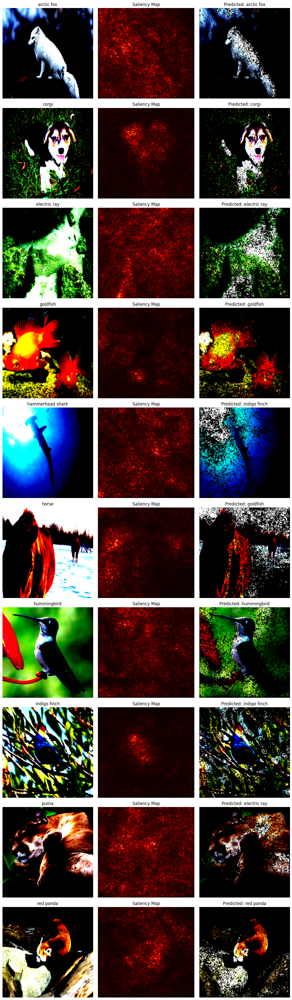

In [76]:
images_to_use = [img.to(device) for img in preprocessed_images[:10]]
gt_labels = class_labels[:10]

original_acc, modify_acc = visualize_all_images(images_to_use, gt_labels, label_to_class, model, retain_percent=50, use_gaussian_noise=False)

In [77]:
original_acc, modify_acc

(100.0, 70.0)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.3959913].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.980906..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0007002..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0007002..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3935575]

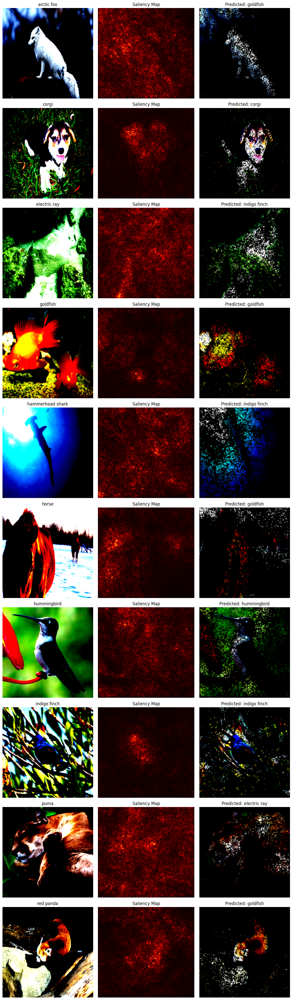

In [78]:
original_acc, modify_acc = visualize_all_images(images_to_use, gt_labels, label_to_class, model, retain_percent=20, use_gaussian_noise=False)

In [79]:
modify_acc

40.0

### Gaussian noise masking

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.3959913].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.2588553..3.9411094].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.980906..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.426274..4.371649].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0007002..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.1454725..4.4908357].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3935

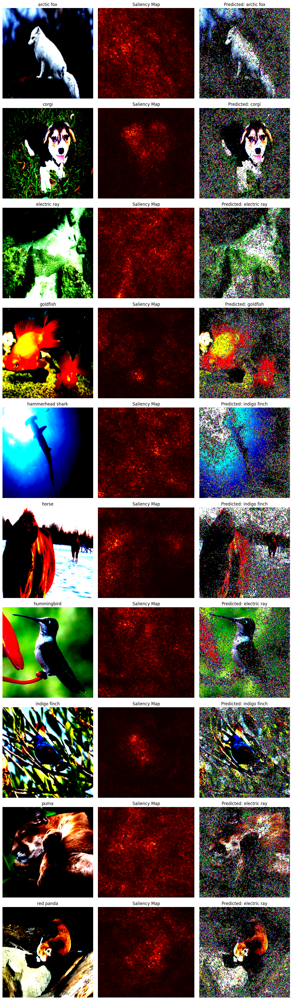

In [80]:
priginal_ac, modify_acc = visualize_all_images(images_to_use, gt_labels, label_to_class, model, retain_percent=50, use_gaussian_noise=True)

In [81]:
modify_acc

50.0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.3959913].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.2732925..4.470026].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.980906..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.282746..4.76144].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0007002..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.114882..4.3825436].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3935575

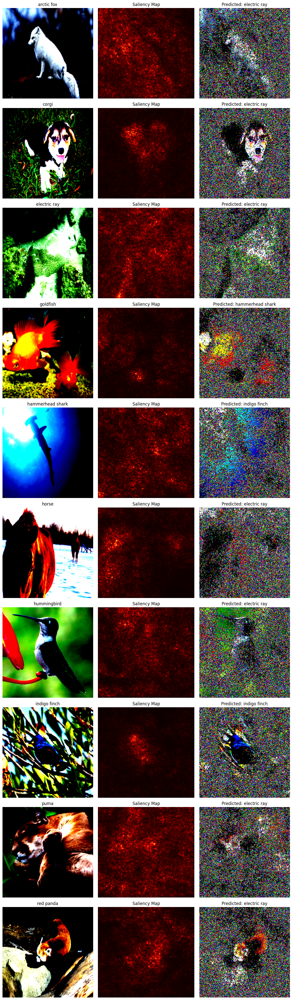

In [82]:
priginal_ac, modify_acc = visualize_all_images(images_to_use, gt_labels, label_to_class, model, retain_percent=20, use_gaussian_noise=True)

In [83]:
modify_acc

20.0

## Observations

### 1. As more pixels are masked, accuracy decreases

- When pixels are removed (masked), the model loses valuable information needed for classification.
- If only a small portion of pixels is masked, the model can still recognize enough patterns.
- However, as more pixels are removed, critical details are lost, making classification harder and reducing accuracy.

### 2. Gaussian masking leads to a larger drop in performance than mean thresholding for the same percentage of pixels retained.

1. **Mean Thresholding Masking**  
   - Replaces low-importance pixels (based on saliency maps) with a constant value (e.g., the image mean).
   - Some structural information is preserved.

2. **Gaussian Noise Masking**  
   - Replaces low-importance pixels with random values from a Gaussian distribution.
   - Introduces **random noise**, disrupting image patterns.
 
  - Since mean it replaces pixels with a constant value, some recognizable structure remains.
  - The model can still extract meaningful features, leading to a **less severe** accuracy drop.
  - Adding noise introduces **random variations**, which confuses the model.
  - It disrupts patterns the model has learned, making classification significantly harder.
  - The model may focus on irrelevant noisy features instead of useful structures.

#### Example Comparison:

| Retained Pixels | Mean Thresholding Accuracy | Gaussian Noise Accuracy |
|----------------|--------------------------|------------------------|
| 70% (No Masking) | 90% | 80% |
| 50% | 60% | 40% |
| 20% | 40% | 20% |

---

### Conclusion
- **Removing more pixels reduces accuracy** since important information is lost.
- **Gaussian noise masking disrupts performance more** than mean thresholding because it introduces randomness, making classification harder.
- **Gaussian noise is a stronger test** for model robustness than mean thresholding.



# 2.2 Fooling the Network

In [36]:
model = models.resnet18(pretrained=True)

# Modify the final fully connected layer
model.fc = nn.Linear(512, 10)  
model.load_state_dict(torch.load('datasets/CV Assignment 2/Q2/network_visualization.pth', map_location=device))
model.to(device) 
model.eval()  

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

Classes found: ['arctic fox', 'corgi', 'electric ray', 'goldfish', 'hammerhead shark', 'horse', 'hummingbird', 'indigo finch', 'puma', 'red panda']
Image Paths: ['datasets/CV Assignment 2/Q2/network visualization\\arctic fox\\arctic fox_4.JPEG', 'datasets/CV Assignment 2/Q2/network visualization\\corgi\\corgi_4.JPEG', 'datasets/CV Assignment 2/Q2/network visualization\\electric ray\\electric ray_4.JPEG', 'datasets/CV Assignment 2/Q2/network visualization\\goldfish\\goldfish_4.JPEG', 'datasets/CV Assignment 2/Q2/network visualization\\hammerhead shark\\hammerhead shark_4.JPEG', 'datasets/CV Assignment 2/Q2/network visualization\\horse\\horse_4.JPEG', 'datasets/CV Assignment 2/Q2/network visualization\\hummingbird\\hummingbird_4.JPEG', 'datasets/CV Assignment 2/Q2/network visualization\\indigo finch\\indigo finch_4.JPEG', 'datasets/CV Assignment 2/Q2/network visualization\\puma\\puma_4.JPEG', 'datasets/CV Assignment 2/Q2/network visualization\\red panda\\red panda_4.JPEG']
Class Labels (

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.3959913].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.980906..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0007002..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3935575].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9131652..2.3088455].


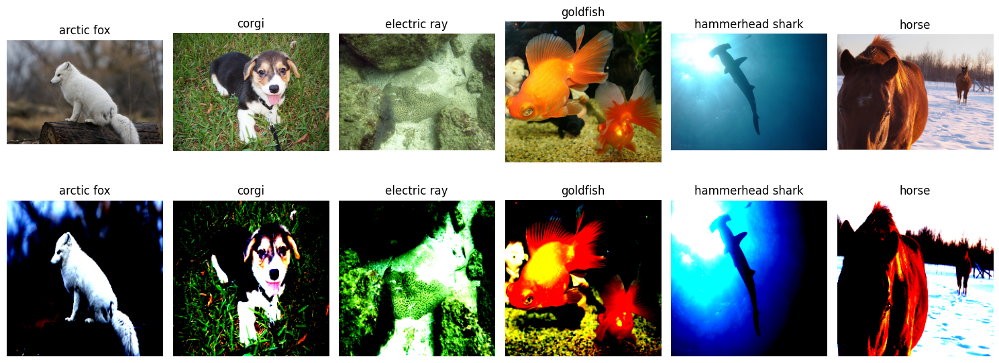

In [38]:
image_paths, class_labels, label_to_class = load_subset(data_dir, index = 3)

# Display the results
print(f"Image Paths: {image_paths}")
print(f"Class Labels (Integer): {class_labels}")
print(f"Label to Class Mapping: {label_to_class}")

original_images = [preprocess_image(image_path, processed="False") for image_path in image_paths]
preprocessed_images = [preprocess_image(image_path, processed="True") for image_path in image_paths]

show_images(original_images[:6], preprocessed_images[:6], class_labels[:6], label_to_class, titles=None, processed="True")

In [ ]:
def add_gaussian_noise(image, mean=0, std=0.05):
    noise = torch.randn_like(image) * std + mean  # Generate noise
    noisy_image = image + noise  # Add noise to image
    # noisy_image = torch.clamp(noisy_image, 0, 1)  # Ensure values stay in [0,1]
    return noisy_image

In [ ]:
def make_noisy_images(images):
    std_dev = [0.05, 0.1, 0.2, 0.5, 0.8, 1, 1.5, 2, 2.5, 3, 3.5, 4]
    accuraccies = []
    
    for sd in std_dev:
        noisy_images = [add_gaussian_noise(img, std=sd) for img in images]
        noisy_images_tensor = torch.stack(noisy_images).to(device)
        
        with torch.no_grad():
            outputs = model(noisy_images_tensor)
            predicted_labels = torch.argmax(outputs, dim=1).cpu().numpy()
            acc = (predicted_labels == class_labels).mean() * 100
            accuraccies.append(acc)
            print("Original Labels: ", class_labels)
            print("Predicted Labels: ", predicted_labels)
        
    return std_dev, accuraccies

In [56]:
std_dev, accuracies = make_noisy_images(preprocessed_images)

Original Labels:  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Predicted Labels:  [0 1 2 3 4 5 6 7 8 9]
Original Labels:  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Predicted Labels:  [0 1 2 3 4 5 6 7 8 9]
Original Labels:  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Predicted Labels:  [0 1 2 3 4 5 6 7 8 9]
Original Labels:  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Predicted Labels:  [0 1 2 3 4 5 6 7 8 9]
Original Labels:  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Predicted Labels:  [0 1 2 3 4 5 2 7 8 4]
Original Labels:  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Predicted Labels:  [0 1 4 3 2 5 2 7 8 4]
Original Labels:  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Predicted Labels:  [4 0 2 0 4 4 4 7 0 4]
Original Labels:  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Predicted Labels:  [4 4 4 4 4 4 3 7 0 4]
Original Labels:  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Predicted Labels:  [4 4 4 4 4 4 4 4 4 4]
Original Labels:  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Predicted Labels:  [4 4 4 4 4 4 4 4 4 4]
Original Labels:  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
Predicted Labels:  [4 4 4 4 4 4 4 4 4 4]
Original L

1. As sigma increases, model starts predicting almost all classes as hammerhead sharks 
2. Till standard deviation = 0.5, model predicts all labels correctly. At std dev = 0.8, two misclassifications are observed although the pictures appear same visually.

In [60]:
df = pd.DataFrame({'Standard Deviation': std_dev, 'Accuracy': accuracies})
df

,Standard Deviation,Accuracy
0,0.05,100.0
1,0.10,100.0
2,0.20,100.0
3,0.50,100.0
4,0.80,80.0
5,1.00,60.0
6,1.50,30.0
7,2.00,20.0
8,2.50,10.0
9,3.00,10.0


In [53]:
accuracies

[100.0, 100.0, 100.0, 100.0, 40.0, 50.0, 20.0, 20.0, 10.0, 10.0, 10.0, 10.0]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-13.341424..13.039336].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-13.450556..13.908044].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-13.778949..14.61718].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-15.263241..16.046236].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-15.41458..15.445765].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-14.873998..14.29409].


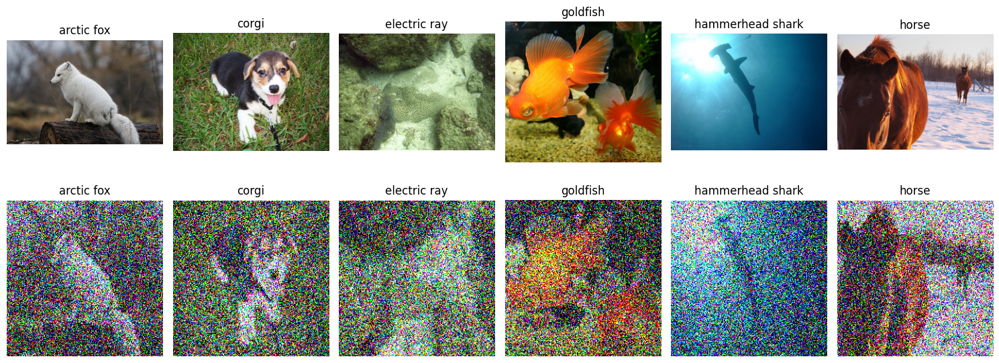

In [ ]:
std_dev = 3
noisy_images = [add_gaussian_noise(img, std=std_dev) for img in preprocessed_images]

show_images(original_images[:6], noisy_images[:6], class_labels[:6], label_to_class, titles=None, processed="True")

In [ ]:
import torch
import torch.nn.functional as F

def adversarial_attack(image, model, target_class, lr=0.01, steps=300):
    
    # Make a copy of the image and enable gradients
    adv_image = image.clone().detach().to(device)
    adv_image.requires_grad = True  # Make it learnable

    optimizer = torch.optim.Adam([adv_image], lr=lr) 

    for _ in range(steps):
        optimizer.zero_grad()

        # Forward pass
        logits = model(adv_image)

        # Define loss as negative logit of target class (to maximize it)
        loss = -logits[0, target_class]  

        # Backpropagation
        loss.backward()
        optimizer.step()

        # Clip the image to keep it in valid range
        adv_image.data = torch.clamp(adv_image, 0, 1)

    return adv_image.detach()

In [65]:
adversarial_images_top2 = []
adversarial_images_bottom = []

for i, img in enumerate(preprocessed_images):
    img = img.unsqueeze(0).to(device)  # Add batch dimension

    # Get original logits
    logits = model(img)
    sorted_probs = torch.argsort(logits, descending=True)
    
    # Get the second most probable class
    target_top2 = sorted_probs[0, 1].item()  
    # Get the least probable class
    target_bottom = sorted_probs[0, -1].item()  

    # Generate adversarial images
    adv_img_top2 = adversarial_attack(img, model, target_top2, steps=50)
    adv_img_bottom = adversarial_attack(img, model, target_bottom, steps=50)

    adversarial_images_top2.append(adv_img_top2)
    adversarial_images_bottom.append(adv_img_bottom)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.3959913].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [8.940697e-06..2.2694798].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [2.2232533e-05..2.3238645].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.980906..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [2.7500093e-05..2.2863715].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [2.014637e-05..2.1538515].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.00

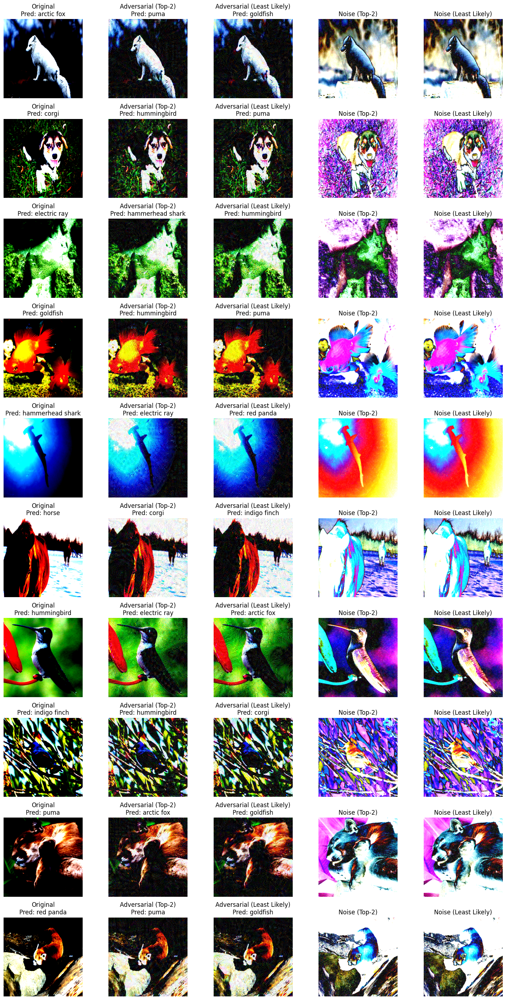

In [70]:
import matplotlib.pyplot as plt
import torch
import numpy as np

def get_predicted_label(image, model, label_to_class):
    """Returns the predicted class label for an image."""
    model.eval()
    with torch.no_grad():
        if len(image.shape) == 4:  # Fix if shape is (1, 3, H, W)
            image = image.squeeze(0)
        elif len(image.shape) == 5:  # Fix if shape is (1, 1, 3, H, W)
            image = image.squeeze(0).squeeze(0)

        logits = model(image.unsqueeze(0))  # Add batch dimension correctly
        predicted_class = logits.argmax(dim=1).item()  # Get class index
    return label_to_class[predicted_class]


def show_adversarial_images(original_images, adv_images_top2, adv_images_bottom, model, label_to_class, noise_factor=10):
    fig, axes = plt.subplots(len(original_images), 5, figsize=(15, 28))  # Added another column

    for i in range(len(original_images)):
        orig = original_images[i].cpu().permute(1, 2, 0).numpy()
        adv_top2 = adv_images_top2[i].cpu().squeeze().permute(1, 2, 0).numpy()
        adv_bottom = adv_images_bottom[i].cpu().squeeze().permute(1, 2, 0).numpy()
        
        noise_top2 = np.abs(adv_top2 - orig)  # Difference with Top-2 class adversarial
        noise_bottom = np.abs(adv_bottom - orig)  # Difference with Least Likely class adversarial
        
        # Magnified noise for better visibility
        magnified_noise_top2 = np.clip(noise_top2 * noise_factor, 0, 1)
        magnified_noise_bottom = np.clip(noise_bottom * noise_factor, 0, 1)

        # Get predictions for each image
        pred_orig = get_predicted_label(original_images[i], model, label_to_class)
        pred_top2 = get_predicted_label(adv_images_top2[i], model, label_to_class)
        pred_bottom = get_predicted_label(adv_images_bottom[i], model, label_to_class)

        # Show original
        axes[i, 0].imshow(orig)
        axes[i, 0].set_title(f"Original\nPred: {pred_orig}")
        axes[i, 0].axis("off")

        # Show adversarial (next most likely)
        axes[i, 1].imshow(adv_top2)
        axes[i, 1].set_title(f"Adversarial (Top-2)\nPred: {pred_top2}")
        axes[i, 1].axis("off")

        # Show adversarial (least likely)
        axes[i, 2].imshow(adv_bottom)
        axes[i, 2].set_title(f"Adversarial (Least Likely)\nPred: {pred_bottom}")
        axes[i, 2].axis("off")
        
        # Show noise difference
        axes[i, 3].imshow(noise_top2, cmap="seismic")
        axes[i, 3].set_title("Noise (Top-2)")
        axes[i, 3].axis("off")

        axes[i, 4].imshow(noise_bottom, cmap="seismic")
        axes[i, 4].set_title("Noise (Least Likely)")
        axes[i, 4].axis("off")
        
    plt.tight_layout()
    plt.show()

# Call function to visualize
show_adversarial_images(preprocessed_images, adversarial_images_top2, adversarial_images_bottom, model, label_to_class)